In [178]:
%matplotlib inline

In [179]:
import numpy as np
import matplotlib.pyplot as plt
import soundfile as sf
from scipy.signal import spectrogram, lfilter, freqz, tf2zpk, butter, buttord
from scipy.io import wavfile

Vzorkovacia frekvencia: 16000
Celkový počet vzorkov: 54272
Dĺžka: 3.392s
Min hodnota signálu: -6063
Max hodnota signálu: 9041


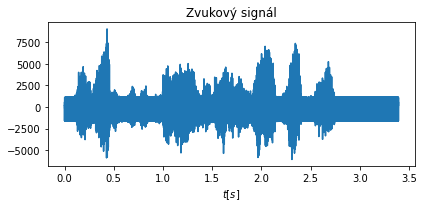

In [180]:
# 4.1

fs, data = wavfile.read('../audio/xkovac61.wav')
print("Vzorkovacia frekvencia: " + str(fs))
print("Celkový počet vzorkov: " + str(data.size))
print("Dĺžka: " + str(data.size/fs)+"s")

print("Min hodnota signálu: " + str(min(data)))
print("Max hodnota signálu: " + str(max(data)))

t = np.arange(data.size) / fs
plt.figure(figsize=(6,3))
plt.plot(t, data)

plt.gca().set_xlabel('$t[s]$')
plt.gca().set_title('Zvukový signál')

plt.tight_layout()

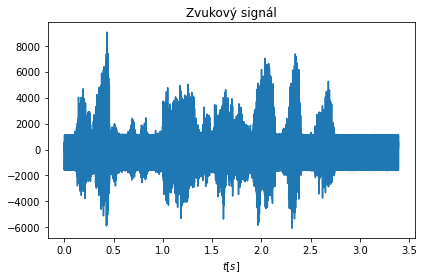

In [181]:
# 4.2

data = data - np.mean(data)
plt.plot(t, data)
plt.gca().set_xlabel('$t[s]$')
plt.gca().set_title('Zvukový signál')

plt.tight_layout()

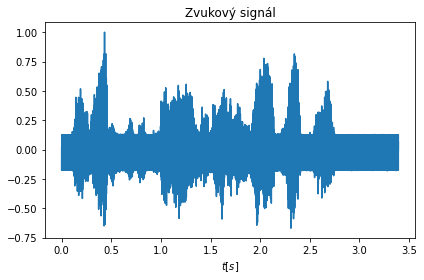

In [182]:
data = data / max(abs(data))

plt.plot(t, data)
plt.gca().set_xlabel('$t[s]$')
plt.gca().set_title('Zvukový signál')

plt.tight_layout()

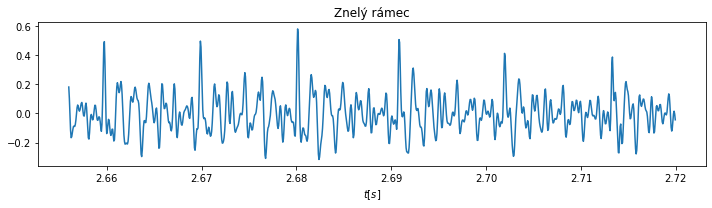

In [183]:
matrix = []

for i in range(0, len(data), 1024-512):
	d = data[i:i+1024]
	matrix.append(np.full((1024), np.pad(d, (0, 1024 - d.size), 'constant')))

matrix = np.array(matrix)
matrix = np.stack(matrix)

# vykreslenie vsetkych ramcov
# for i, s in enumerate(matrix):
# 	plt.figure(figsize=(10,3))
# 	plt.plot(np.arange((i * 512), (i * 512) + s.size) / fs, s)
# 	plt.gca().set_xlabel('$t[s]$')
# 	plt.gca().set_title("Ramec " + str(i))

# 	plt.tight_layout()
# 	plt.show()

# vykreslenie n-teho ramca
n = 83
plt.figure(figsize=(10,3))
plt.plot(np.arange((n * 512), (n * 512) + matrix[n].size) / fs, matrix[n])
plt.gca().set_xlabel('$t[s]$')
plt.gca().set_title('Znelý rámec')

plt.tight_layout()

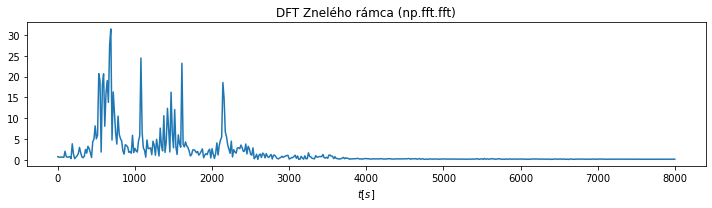

In [184]:
# 4.3

seg = matrix[n]
N = seg.size
G = np.fft.fft(seg)
f = np.arange(G.size) / N * fs

plt.figure(figsize=(10,3))
plt.plot(f[:f.size//2+1], abs(G[:G.size//2+1]))
plt.gca().set_xlabel('$t[s]$')
plt.gca().set_title('DFT Znelého rámca (np.fft.fft)')

plt.tight_layout()

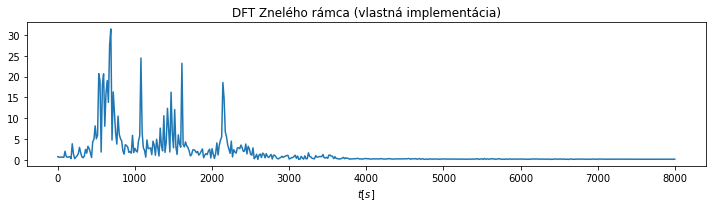

In [185]:
def DFT_matrix(N):
    i, j = np.meshgrid(np.arange(N), np.arange(N))
    omega = np.exp(-2 * np.pi * 1j / N )
    W = np.power( omega, i * j )
    return W

W = DFT_matrix(1024)

seg = matrix[n]
N = seg.size
G = W.dot(seg)
f = np.arange(G.size) / N * fs

plt.figure(figsize=(10,3))
plt.plot(f[:f.size//2+1], abs(G[:G.size//2+1]))
plt.gca().set_xlabel('$t[s]$')
plt.gca().set_title('DFT Znelého rámca (vlastná implementácia)')

plt.tight_layout()

f1: 535
f2: 1070 = 2 * f1
f3: 1605 = 3 * f1
f4: 2140 = 4 * f1
Rušivé signály sú harmonicky vztažené


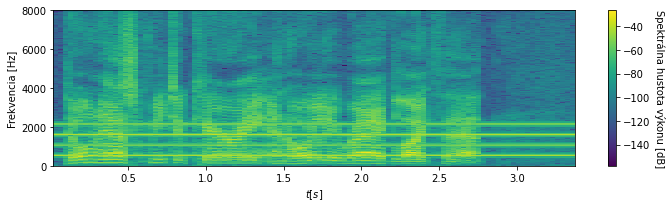

In [186]:
# 4.4

f, time, sgr = spectrogram(data, fs, nperseg=1024, noverlap=512)
sgr_log = 10 * np.log10(sgr+1e-20)

plt.figure(figsize=(10,3))
plt.pcolormesh(time,f,sgr_log)
plt.gca().set_xlabel('$t[s]$')
plt.gca().set_ylabel('Frekvencia [Hz]')
cbar = plt.colorbar()
cbar.set_label('Spektrálna hustota výkonu [dB]', rotation=270, labelpad=15)

plt.tight_layout()

# 4.5

F = [535, 1070, 1605, 2140]
print("f1: " + str(F[0]))
print("f2: " + str(F[1]) + " = 2 * f1")
print("f3: " + str(F[2]) + " = 3 * f1")
print("f4: " + str(F[3]) + " = 4 * f1")
print("Rušivé signály sú harmonicky vztažené");

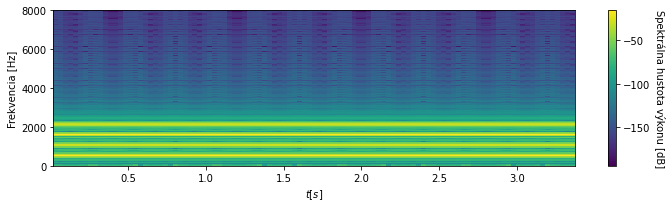

In [187]:
# 4.6

cosSignal = np.cos(t * np.pi * 2 * F[0])
cosSignal += np.cos(t * np.pi * 2 * F[1])
cosSignal += np.cos(t * np.pi * 2 * F[2])
cosSignal += np.cos(t * np.pi * 2 * F[3])

f, time, sgr = spectrogram(cosSignal, fs, nperseg=1024, noverlap=512)
sgr_log = 10 * np.log10(sgr+1e-20)

plt.figure(figsize=(10,3))
plt.pcolormesh(time,f,sgr_log)
plt.gca().set_xlabel('$t[s]$')
plt.gca().set_ylabel('Frekvencia [Hz]')
cbar = plt.colorbar()
cbar.set_label('Spektrálna hustota výkonu [dB]', rotation=270, labelpad=15)

plt.tight_layout()

sf.write("../audio/4cos.wav", cosSignal, fs)

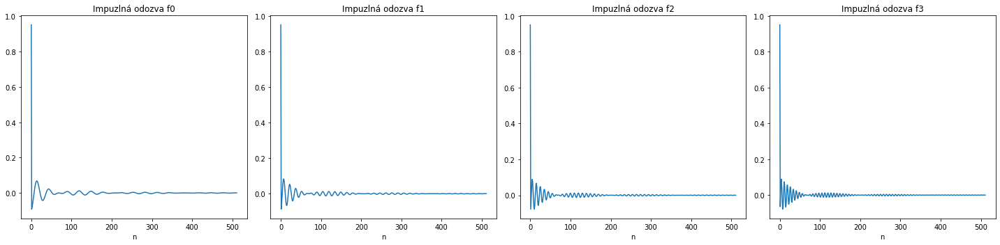

In [188]:
# 4.7

filter_nom_denom = []

for idx, freq in enumerate(F):
	f_ord, wn = buttord([(F[idx] - 50), (F[idx] + 50)], [(F[idx] - 15), (F[idx] + 15)], 3, 40, fs=fs)
	filter_nom_denom.append(butter(f_ord, wn, 'bandstop', fs=fs))


_, ax = plt.subplots(1, 4, figsize=(20,5))

N_imp = 512
impulse = np.zeros(N_imp)
impulse[0] = 1

for idx, nom_denom in enumerate(filter_nom_denom):
	filtered_impulse = lfilter(filter_nom_denom[idx][0], filter_nom_denom[idx][1], impulse)
	ax[idx].plot(np.arange(N_imp), filtered_impulse)
	ax[idx].set_xlabel('n')
	ax[idx].set_title('Impuzlná odozva f{}'.format(idx))

plt.tight_layout()


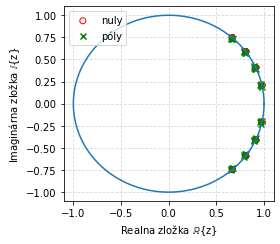

In [189]:
# 4.8

z_arr = []
p_arr = []
for idx, nom_denom in enumerate(filter_nom_denom):
	z, p, k = tf2zpk(nom_denom[0], nom_denom[1])
	# nuly, poly
	z_arr.append(z)
	p_arr.append(p)
	
plt.figure(figsize=(4,3.5))

# jednotkova kruznice
ang = np.linspace(0, 2*np.pi,100)
plt.plot(np.cos(ang), np.sin(ang))
	
plt.scatter([np.real(z) for z in z_arr], [np.imag(z) for z in z_arr], marker='o', facecolors='none', edgecolors='r', label='nuly')
plt.scatter([np.real(p) for p in p_arr], [np.imag(p) for p in p_arr], marker='x', color='g', label='póly')

plt.gca().set_xlabel('Realna zložka $\mathbb{R}\{$z$\}$')
plt.gca().set_ylabel('Imaginárna zložka $\mathbb{I}\{$z$\}$')

plt.grid(alpha=0.5, linestyle='--')
plt.legend(loc='upper left')

plt.tight_layout()

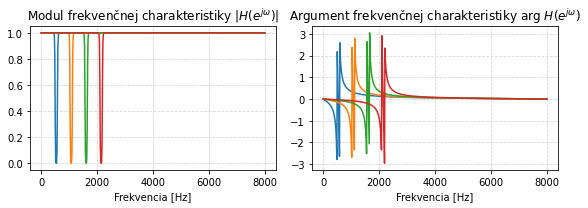

In [190]:
# 4.9

_, ax = plt.subplots(1, 2, figsize=(8,3))

for idx, nom_denom in enumerate(filter_nom_denom):
	w, H = freqz(nom_denom[0], nom_denom[1])
	ax[0].plot(w / 2 / np.pi * fs, np.abs(H))
	ax[1].plot(w / 2 / np.pi * fs, np.angle(H))
	
ax[0].set_xlabel('Frekvencia [Hz]')
ax[0].set_title('Modul frekvenčnej charakteristiky $|H(e^{j\omega})|$')

ax[1].set_xlabel('Frekvencia [Hz]')
ax[1].set_title('Argument frekvenčnej charakteristiky $\mathrm{arg}\ H(e^{j\omega})$')

for ax1 in ax:
    ax1.grid(alpha=0.5, linestyle='--')

plt.tight_layout()

In [191]:
# 4.10

filtered_signal = data

for idx, fil in enumerate(filter_nom_denom):
	filtered_signal = lfilter(filter_nom_denom[idx][0], filter_nom_denom[idx][1], filtered_signal)

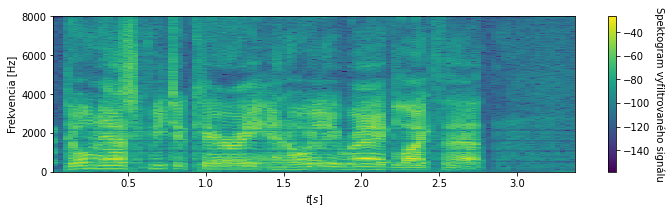

In [192]:
f, time, sgr = spectrogram(filtered_signal, fs, nperseg=1024, noverlap=512)
sgr_log = 10 * np.log10(sgr+1e-20)

plt.figure(figsize=(10,3))
plt.pcolormesh(time,f,sgr_log)
plt.gca().set_xlabel('$t[s]$')
plt.gca().set_ylabel('Frekvencia [Hz]')
cbar = plt.colorbar()
cbar.set_label('Spektrálna hustota výkonu [dB]', rotation=270, labelpad=15)

plt.tight_layout()

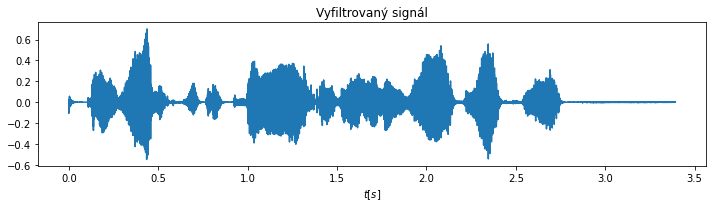

In [193]:

plt.figure(figsize=(10,3))
plt.plot(t, filtered_signal)
plt.gca().set_xlabel('$t[s]$')
plt.gca().set_title('Vyfiltrovaný signál')

plt.tight_layout()

sf.write("../audio/clean_bandstop.wav", filtered_signal, fs)